In [ ]:
!apt-get update
!apt-get install -y ffmpeg
!apt-get install xvfb
!pip install gymnasium
!pip install -q swig
!pip install -q gymnasium[box2d]
!pip install pyvirtualdisplay
!pip install Pillow

In [ ]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import gymnasium as gym
import tensorflow as tf
import matplotlib.pyplot as plt
import io
import os
import base64
import tensorflow as tf
from gym.wrappers.monitoring import video_recorder
from IPython.display import HTML

# Funções auxiliares

In [ ]:
from pyvirtualdisplay import Display
display = Display(visible=0, size=(1400, 900))
display.start()

In [ ]:
def show_video():
  """
  Função que mostra o vídeo do treinamento na saída da célula
  """
  mp4list = list(filter(lambda x: x.endswith('.mp4'), os.listdir('.')))
  if len(mp4list) > 0:
      mp4 = mp4list[0]
      video = io.open(mp4, 'r+b').read()
      encoded = base64.b64encode(video)
      return HTML(data='''<video alt="test" autoplay
                  loop controls style="height: 400px;">
                  <source src="data:video/mp4;base64,{0}" type="video/mp4" />
                </video>'''.format(encoded.decode('ascii')))
  else:
      print("No videos found.")

In [ ]:
def build_model(input_shape, output_shape):
    """
    Cria o modelo da rede neural com 3 camadas ocultas com 30 neurônios cada

    input_shape: forma do espaço de observação do Lunar Lander
    output_shape: número de ações do agente (número de neurônios na camada de saída)
    retorna um modelo do tensorflow
    """
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(30, input_shape=input_shape, activation="relu"))
    model.add(tf.keras.layers.Dense(30, activation="relu"))
    model.add(tf.keras.layers.Dense(30, activation="relu"))
    model.add(tf.keras.layers.Dense(output_shape))
    model.compile(loss="mse", optimizer=tf.keras.optimizers.Adam())
    return model

# Algoritmo e Agente

In [ ]:
# Hiperparâmetros
gamma = 0.9
epsilon = 1.0
epsilon_decay = 0.995
epsilon_min = 0.1
episodes = 1000
lr = 0.001

In [ ]:
# caso queira utilizar o modelo já treinado com o código abaixo
saved_model = tf.keras.models.load_model("trained_model.h5")

Como o problema do Lunar Lander possui espaços de observação contínuos, não é possível realizar o Q-Learning, já que este funciona com estados discretos (senão não é possível criar a tabela Q). Dessa forma, foi implementado o Deep Q-Networks (DQN), uma forma de resolver o Q-Learning com redes neurais. Com o DQN é possível manter as observações contínuas, sem ter que discretizá-las.

In [ ]:
env = gym.make("LunarLander-v2", render_mode="rgb_array")
input_shape = (env.observation_space.shape[0],)
output_shape = env.action_space.n
model = build_model(input_shape, output_shape)
vid_recorder = video_recorder.VideoRecorder(env, path="lunar-lander.mp4")

# Armazena as recompensas de cada episódio
ep_reward_list = []

for episode in range(1000):
  state = env.reset()[0].reshape(1, 8)
  done = False
  episode_reward = 0

  while not done:

    # Política Epsilon-greedy: balanceamento entre exploração (escolher uma ação aleatória) e explotação (escolher a melhor ação)
    if np.random.rand() <= epsilon:
        action = np.random.randint(2)
    else:
        q_values = model.predict(state, verbose=0)
        action = np.argmax(q_values[0])

    next_state, reward, done, _, _ = env.step(action)
    vid_recorder.capture_frame()
    next_state = next_state.reshape(1, 8)

    target = reward

    # Atualiza a rede para a ação tomada usando a equação de Bellman e executa uma única atualização de gradiente em um lote que contenha apenas o estado atual.
    # Segue o mesmo princípio do Q-Learning, em que a equação de Bellman é usada para atualizar os Qs. No caso da rede, a atualização dos pesos é feita para garantir que sua saída seja os valores de Q ótimos para cada ação.
    if not done:
      target = reward + gamma * np.max(model.predict(next_state, verbose=0)[0])
      q_values[0][action] = target
      model.train_on_batch(state, q_values)

      state = next_state
      episode_reward += reward

  ep_reward_list.append(episode_reward)

  epsilon = max(epsilon_min, epsilon_decay*epsilon)
  print(f"Episode: {episode + 1}, Reward: {episode_reward}")

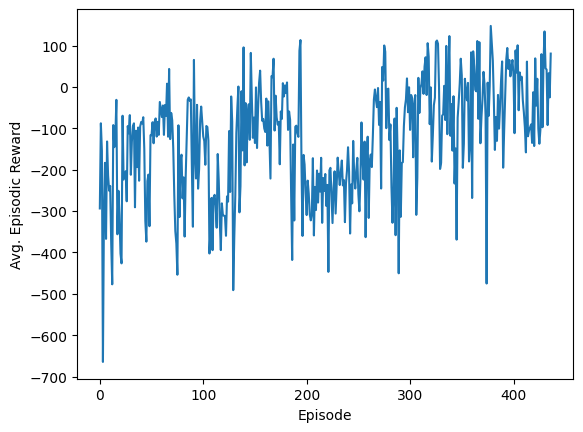

In [ ]:
# gráfico Episódio x Recompensa
plt.plot(ep_reward_list)
plt.xlabel("Episode")
plt.ylabel("Avg. Episodic Reward")
plt.show()
vid_recorder.close()
env.close()

# mostra o vídeo do treinamento
show_video()

In [ ]:
# salva o modelo para uso futuro
model.save("trained_model.h5")

## Análise
Com o gráfico acima é possível perceber que ao longo do treinamento, conforme o número de episódios aumenta, a recompensa tende a aumentar, apesar de variações, estas que tendem a diminuir ao longo do tempo (em certos intervalos variou de 100 a -400 e mais para o final de 100 a -200). Por exemplo, com 400 episódios as recompensas não cairam de -200, diferentemente do início, que chegou a quase -700. Assim, o modelo está se comportando como o esperado e com mais tempo de treinamento, provavelmente irá convergir para uma solução que maximize a recompensa obtida.  